In [1]:
import os
import numpy as np
import random
import matplotlib.pyplot as plt
from matplotlib import cm
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

from utils import fit_bspline, fit_polynomial, calculate_num_frames, prepare_window_data



In [2]:
%ls

function_fitting.ipynb  img/  paths/  __pycache__/  utils.py


### Load Data

In [3]:
def load_random_npy_file(folder_path):
    # List all files in the folder
    npy_files = [f for f in os.listdir(folder_path) if f.endswith('.npy')]
    if len(npy_files) == 0:
        print("No .npy files found in the folder.")
        return None

    # Randomly choose one of the .npy files
    random_file = random.choice(npy_files)
    file_path = os.path.join(folder_path, random_file)
    print(file_path)
    # Load the randomly selected .npy file
    data = np.load(file_path)

    print(f"Loaded {random_file}")
    return data

random.seed(1)
folder_path = 'paths/'
# 6 waypoints, 
path = load_random_npy_file(folder_path)

paths/path185.npy
Loaded path185.npy


In [4]:
joint_states = path.reshape(-1, 7)
print(joint_states.shape)
print(joint_states[:, 1].shape)


(192, 7)
(192,)


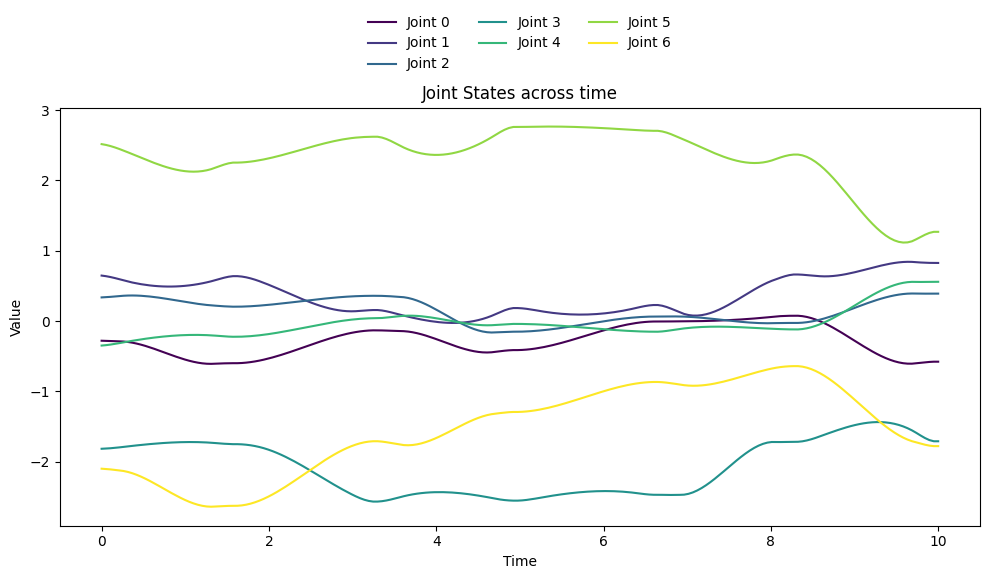

In [5]:
cmap = cm.viridis
norm = plt.Normalize(vmin=0, vmax=6)
t = np.linspace(0, 10, 192)
plt.figure(figsize=(10, 6))
for i in range(0, 7):
    color = cmap(norm(i))
    plt.plot(t, joint_states[:, i], label=f'Joint {i}', color=color)


plt.xlabel('Time')
plt.ylabel('Value')
plt.title('Joint States across time')
plt.legend(loc='upper center', bbox_to_anchor=(0.5, 1.25), ncol=3, frameon=False)
plt.tight_layout()
plt.show()

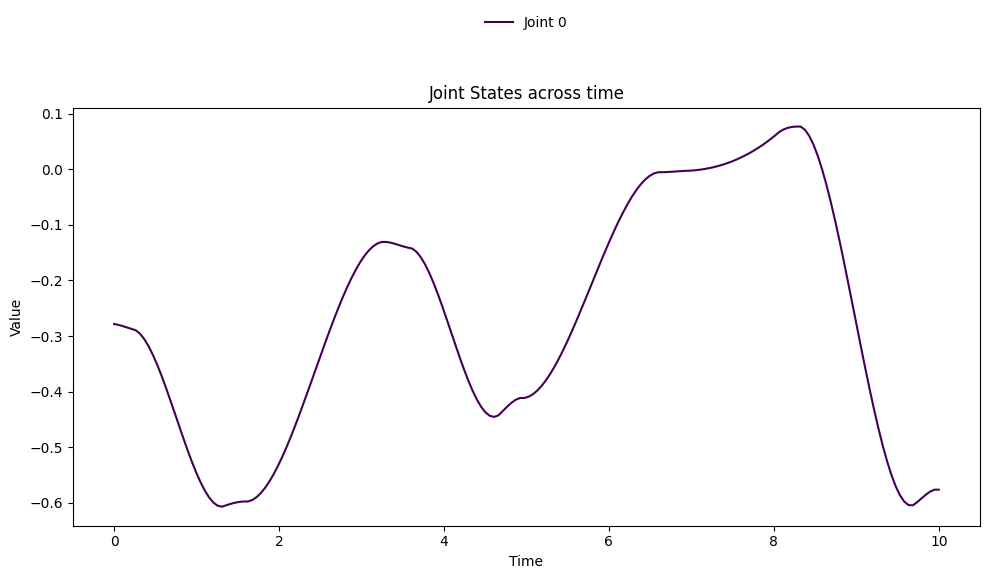

In [6]:
cmap = cm.viridis
norm = plt.Normalize(vmin=0, vmax=6)
t = np.linspace(0, 10, 192)
plt.figure(figsize=(10, 6))
for i in range(0, 1):
    color = cmap(norm(i))
    plt.plot(t, joint_states[:, i], label=f'Joint {i}', color=color)


plt.xlabel('Time')
plt.ylabel('Value')
plt.title('Joint States across time')
plt.legend(loc='upper center', bbox_to_anchor=(0.5, 1.25), ncol=3, frameon=False)
plt.tight_layout()
plt.show()

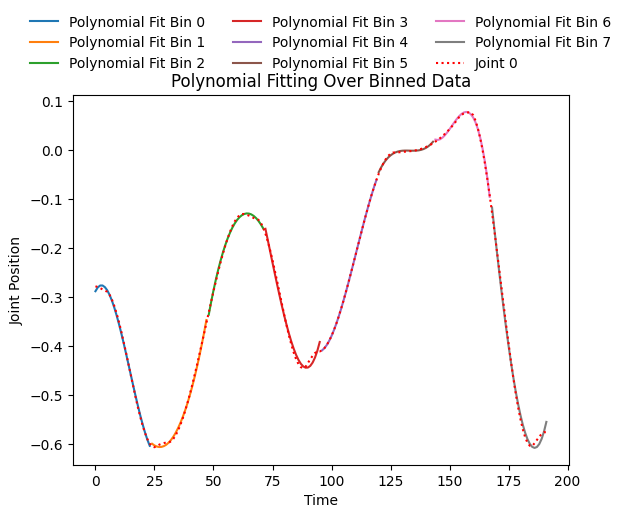

In [7]:
def fit_polynomials_to_bins(data, N_bins, poly_degree=3):
    """
    Fits a polynomial to each bin of the given data.

    Parameters:
    - data (numpy array): The original array (length 192).
    - N_bins (int): The number of bins to divide the data into.
    - poly_degree (int): The degree of the polynomial to fit. Default is 3 (cubic).

    Returns:
    - fitted_polynomials (list): A list of fitted polynomials for each bin.
    """
    # Length of data
    data_length = len(data)
    
    # Calculate bin size
    bin_size = data_length // N_bins
    
    # List to store the fitted polynomials for each bin
    fitted_polynomials = []
    
    # Iterate over bins
    for i in range(N_bins):
        # Define the start and end index for the current bin
        start_idx = i * bin_size
        end_idx = (i + 1) * bin_size if i < N_bins - 1 else data_length  # Ensure last bin includes all remaining points
        
        # Time or index for the current bin
        bin_indices = np.arange(start_idx, end_idx)
        
        # Get the data for the current bin
        bin_data = data[start_idx:end_idx]
        
        # Fit a polynomial to the current bin's data
        poly_coeff = np.polyfit(bin_indices, bin_data, poly_degree)
        
        # Store the polynomial coefficients for later use
        fitted_polynomials.append(poly_coeff)
        
        # Plot the polynomial fit for the current bin
        poly_fit = np.polyval(poly_coeff, bin_indices)
        plt.plot(bin_indices, poly_fit, label=f'Polynomial Fit Bin {i}')
    
    return fitted_polynomials


joint_data = joint_states[:, 0]
    
# Number of bins
N_bins = 8 
    
# Call the function to fit polynomials
fitted_polynomials = fit_polynomials_to_bins(joint_data, N_bins)
plt.plot(joint_states[:, 0], label='Joint 0', color='red', linestyle='dotted')
# Show the plot of polynomial fits
plt.xlabel('Time')
plt.ylabel('Joint Position')
plt.title('Polynomial Fitting Over Binned Data')
plt.legend(loc='upper center', bbox_to_anchor=(0.5, 1.25), ncol=3, frameon=False)
plt.show()

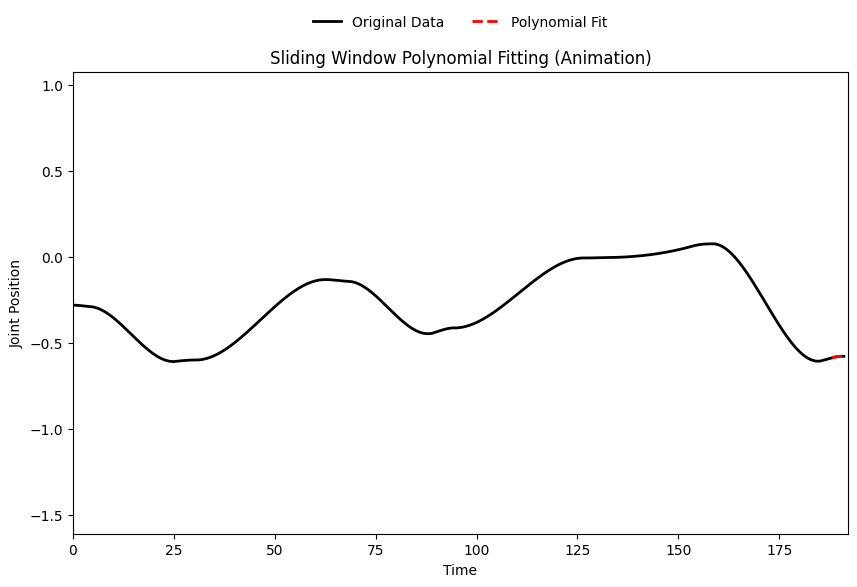

In [8]:
def sliding_window_polynomial_fit_animated(data, window_size, step_size, poly_degree=3):
    """
    Fits a polynomial in a sliding window fashion over the data and animates the unfolding polynomial fits.
    
    Parameters:
    - data (numpy array): The input data array (joint trajectory).
    - window_size (int): The size of the sliding window (number of points per window).
    - step_size (int): The step size for sliding the window.
    - poly_degree (int): The degree of the polynomial to fit.
    
    Returns:
    - anim (FuncAnimation): The animation object.
    """
    data_length = len(data)
    fig, ax = plt.subplots(figsize=(10, 6))

    # Plot the original data (joint position)
    ax.plot(data, label='Original Data', color='black', linewidth=2)

    # Line to display the polynomial fit
    fit_line, = ax.plot([], [], label='Polynomial Fit', linestyle='--', color='red', linewidth=2)

    # Adding labels and title
    ax.set_xlabel('Time')
    ax.set_ylabel('Joint Position')
    ax.set_title('Sliding Window Polynomial Fitting (Animation)')
    ax.legend(loc='upper center', bbox_to_anchor=(0.5, 1.15), ncol=3, frameon=False)

    # Set up limits
    ax.set_xlim(0, data_length)
    ax.set_ylim(np.min(data) - 1, np.max(data) + 1)

    # Function to update the animation
    def update(frame):
        # Use the utility function to extract window data
        window_indices, window_data = prepare_window_data(data, frame, window_size, step_size)

        # Use the utility function to fit a polynomial
        poly_fit = fit_polynomial(window_indices, window_data, poly_degree)

        # Update the line
        fit_line.set_data(window_indices, poly_fit)
        return fit_line,

    # Calculate the number of frames using a utility function
    num_frames = calculate_num_frames(data_length, window_size, step_size)

    # Create the animation
    anim = FuncAnimation(fig, update, frames=num_frames, interval=200, blit=True)

    return HTML(anim.to_jshtml())


joint_data = joint_states[:, 0]

# Parameters for the sliding window
window_size = 4  # Number of points in each window
step_size = 1     # Step size (overlap between windows)
poly_degree = 3   # Degree of the polynomial to fit

# Call the function to animate polynomial fitting
sliding_window_polynomial_fit_animated(joint_data, window_size, step_size, poly_degree)


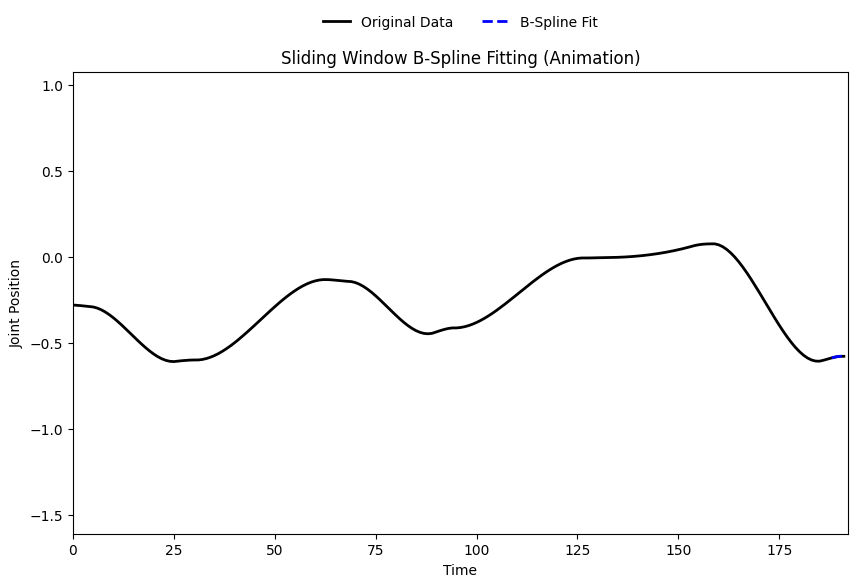

In [9]:
def sliding_window_bspline_fit_animated(data, window_size, step_size, spline_degree=3, num_knots=4):
    """
    Fits a B-spline in a sliding window fashion over the data and animates the unfolding B-spline fits.

    Parameters:
    - data (numpy array): The input data array (joint trajectory).
    - window_size (int): The size of the sliding window (number of points per window).
    - step_size (int): The step size for sliding the window.
    - spline_degree (int): The degree of the B-spline.
    - num_knots (int): Number of knots for the B-spline.

    Returns:
    - anim (FuncAnimation): The animation object.
    """
    data_length = len(data)
    fig, ax = plt.subplots(figsize=(10, 6))

    # Plot the original data (joint position)
    ax.plot(data, label='Original Data', color='black', linewidth=2)

    # Line to display the B-spline fit
    fit_line, = ax.plot([], [], label='B-Spline Fit', linestyle='--', color='blue', linewidth=2)

    # Adding labels and title
    ax.set_xlabel('Time')
    ax.set_ylabel('Joint Position')
    ax.set_title('Sliding Window B-Spline Fitting (Animation)')
    ax.legend(loc='upper center', bbox_to_anchor=(0.5, 1.15), ncol=3, frameon=False)

    # Set up limits
    ax.set_xlim(0, data_length)
    ax.set_ylim(np.min(data) - 1, np.max(data) + 1)

    # Function to update the animation
    def update(frame):
        # Use the utility function `to extract window data
        window_indices, window_data = prepare_window_data(data, frame, window_size, step_size)
        # Use the utility function to fit a B-spline
        bspline_indices, bspline_fit = fit_bspline(window_indices, window_data, spline_degree, num_knots)

        # Update the line
        fit_line.set_data(bspline_indices, bspline_fit)
        return fit_line,

    # Number of frames for the animation
    num_frames = (data_length - window_size) // step_size + 1

    # Create the animation
    anim = FuncAnimation(fig, update, frames=num_frames, interval=200, blit=True)

    return HTML(anim.to_jshtml())

joint_data = joint_states[:, 0]
# Parameters for the sliding window
window_size = 4  # Number of points in each window
step_size = 1     # Step size (overlap between windows)
spline_degree = 3 # Degree of the B-spline
num_knots = 2     # Number of knots in each window

# Call the function to animate B-spline fitting
sliding_window_bspline_fit_animated(joint_data, window_size, step_size, spline_degree, num_knots)
